# Projeto 2 - Emparelhamento máximo em Grafos Bipartidos

## Alunos
- Élvis Corrêa Miranda Júnior - 241038700
- Gustavo Alves Dias - 241020779
- Pedro Marcinoni Varão Ribeiro Vieira da Rosa - 241002396

## Descrição do Projeto
O objetivo desse projeto é implementar um algoritmo para encontrar um emparelhamento máximo em um grafo bipartido. Um grafo bipartido é um grafo cujos vértices podem ser divididos em dois conjuntos disjuntos, de forma que todas as arestas conectam um vértice de um conjunto a um vértice do outro conjunto. Um emparelhamento é um conjunto de arestas sem vértices em comum, e um emparelhamento máximo é aquele que contém o maior número possível de arestas.  

## Requisitos
- Python 3.x
- Biblioteca NetworkX, Pandas e Matplotlib
- Dataset de grafos bipartidos (fornecido no repositório)

## Funcionalidades implementadas
- Leitura de grafos bipartidos a partir de arquivos TXT.
- Implementação do algoritmo de #### para encontrar o emparelhamento máximo.
- Visualização do grafo bipartido e do emparelhamento encontrado em cada iteração.
- Geração de gráficos para análise de desempenho do algoritmo.

## Aplicação
Para esta aplicação, consideramos o problema de alocação de projetos a estudantes. Cada estudante possui uma lista de preferências com até três projetos que gostaria de desenvolver. Além disso, cada projeto pode ser alocado para até dois estudantes, tendo como critério de desempate, além da ordem de preferência, a maior nota do estudante. O objetivo é maximizar a satisfação dos estudantes, alocando-os aos projetos de acordo com suas preferências e notas. A seguir, é apresentamos o código utilizado para constuir o grafo bipartido que será utilizado no algoritmo de emparelhamento máximo.


Grafo bipartido criado com 200 estudantes e 50 projetos
Total de arestas: 289


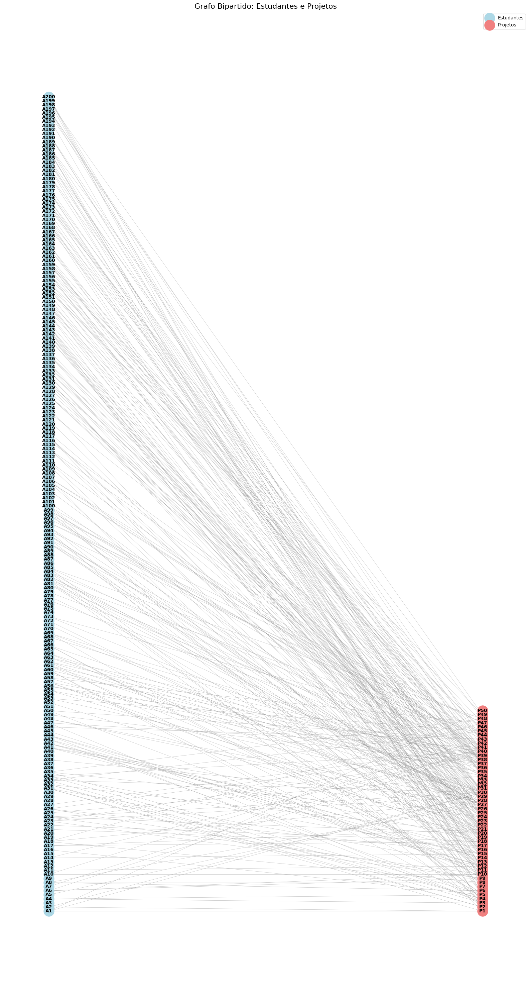

In [1]:
import os
import networkx as nx
from src.preprocessing import preprocessing
import matplotlib.pyplot as plt

G = nx.Graph()

# Obter o caminho do arquivo de dados
current_dir = os.getcwd()
data_path = os.path.join(current_dir, "data", "data.txt")

# Preprocessar os dados para criar objetos de projetos e estudantes
projects, students, projects2, students2 = preprocessing(data_path)

# Adicionar nós ao grafo (estudantes e projetos)
student_nodes = [s.code for s in students]
project_nodes = [p.code for p in projects]

G.add_nodes_from(student_nodes, bipartite=0)  # Estudantes no conjunto 0
G.add_nodes_from(project_nodes, bipartite=1)  # Projetos no conjunto 1

# Adicionar arestas baseadas nas preferências dos estudantes
# e nos requisitos mínimos dos projetos
for student in students:
    for project in student.prefList:
        # Adiciona aresta se o estudante atende ao requisito mínimo de nota
        if student.grade >= project.minGrade:
            G.add_edge(student.code, project.code)

print(f"Grafo bipartido criado com {len(student_nodes)} estudantes e {len(project_nodes)} projetos")
print(f"Total de arestas: {G.number_of_edges()}")

# Visualizar o grafo bipartido
plt.figure(figsize=(16, 30))

# Definir posições para layout bipartido com espaçamento maior
pos = {}
vertical_spacing = 3  # Espaçamento vertical entre nós
# Estudantes à esquerda
for i, node in enumerate(student_nodes):
    pos[node] = (0, i * vertical_spacing)
# Projetos à direita
for i, node in enumerate(project_nodes):
    pos[node] = (10, i * vertical_spacing)

# Desenhar o grafo
nx.draw_networkx_nodes(G, pos, nodelist=student_nodes, 
                       node_color='lightblue', node_size=500, 
                       label='Estudantes')
nx.draw_networkx_nodes(G, pos, nodelist=project_nodes, 
                       node_color='lightcoral', node_size=500, 
                       label='Projetos')
nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color='gray', width=0.5)
nx.draw_networkx_labels(G, pos, font_size=10, font_weight='bold')

plt.title('Grafo Bipartido: Estudantes e Projetos', fontsize=16)
plt.legend(scatterpoints=1, loc='upper right')
plt.axis('off')
plt.tight_layout()
plt.show()

## Algoritmo de Emparelhamento Máximo

O projeto implementa duas variações do **algoritmo SPA (Student-Project Allocation )**, descrito em Abraham, Irving & Manlove (2007), adaptado para produzir um **MEM — Maximum Engineering Matching**. [Explicar mais afundo sobre o algoritmo e suas adaptações]

Nesta seção, vamos acompanhar a evolução do emparelhamento ao longo de dez iterações usando duas variantes do algoritmo SPA:
- `SPAallocation`: estudantes fazem propostas aos projetos.
- `SPAallocation2`: projetos fazem propostas aos estudantes.

**Cores das arestas em cada iteração**
- Proposta ativa: amarelo (`gold`).
- Emparelhamento temporário (atual): verde (`mediumseagreen`).
- Rejeição/remoção: vermelho (`lightcoral`).

Cada figura mostra o grafo bipartido (estudantes à esquerda, projetos à direita) para cada iteração até a convergência ou o limite de 10 passos.

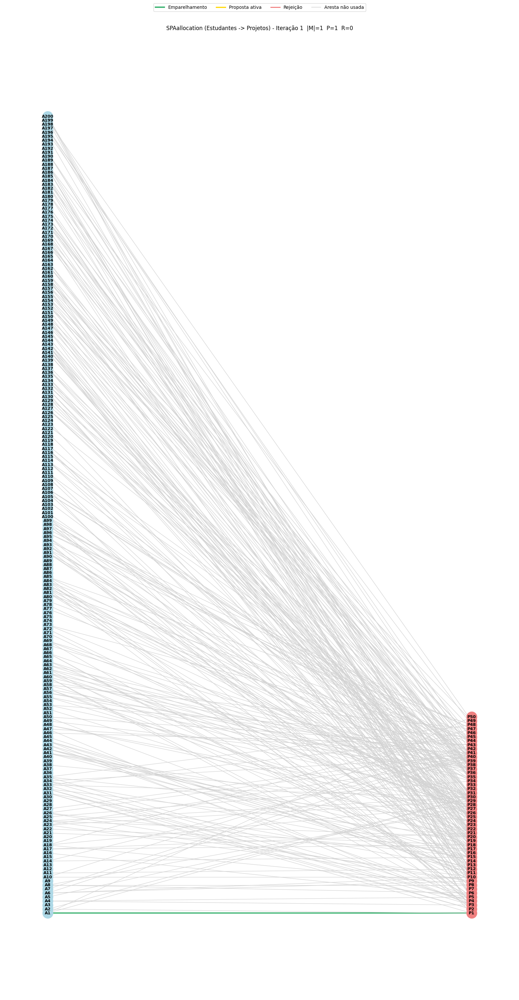

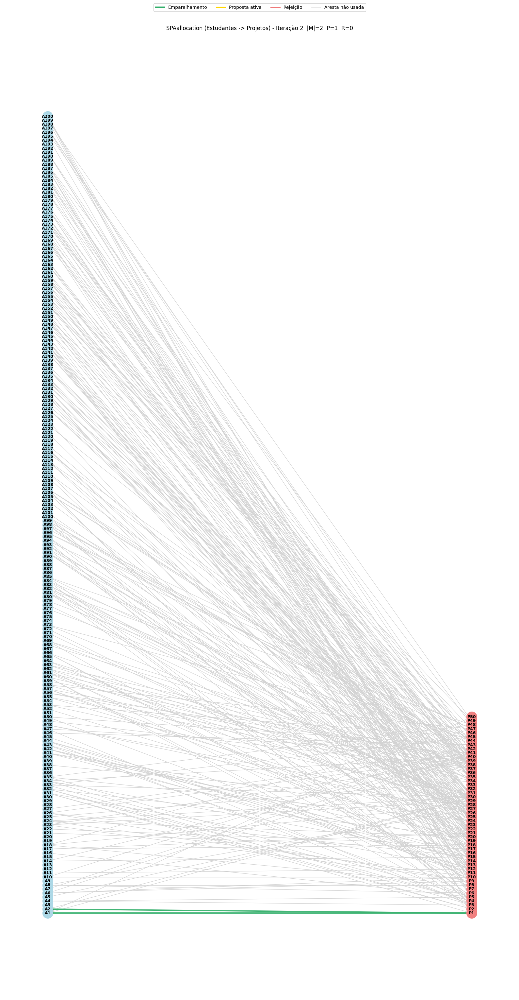

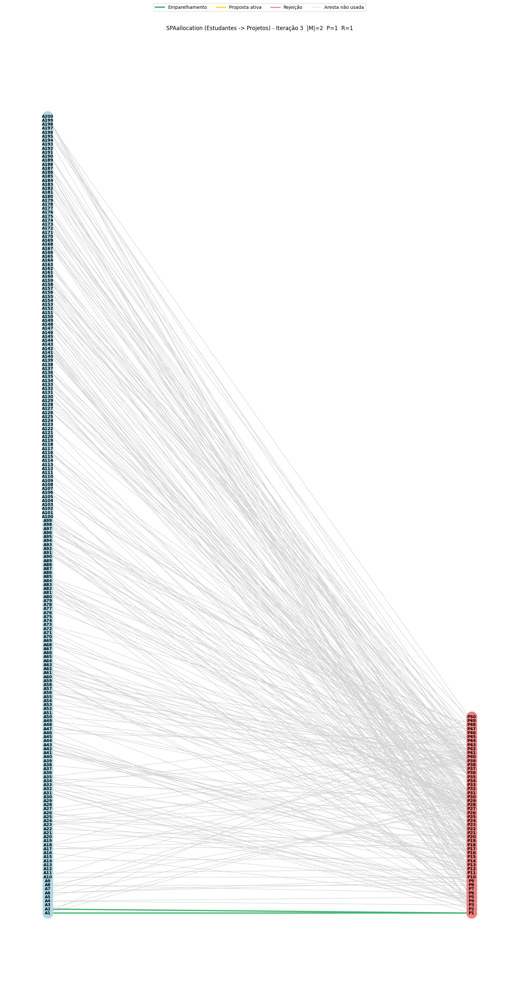

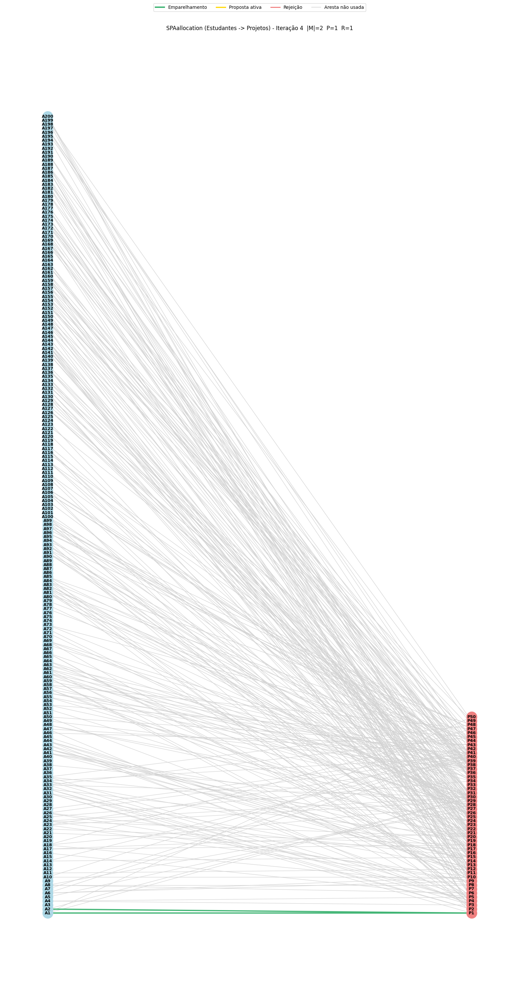

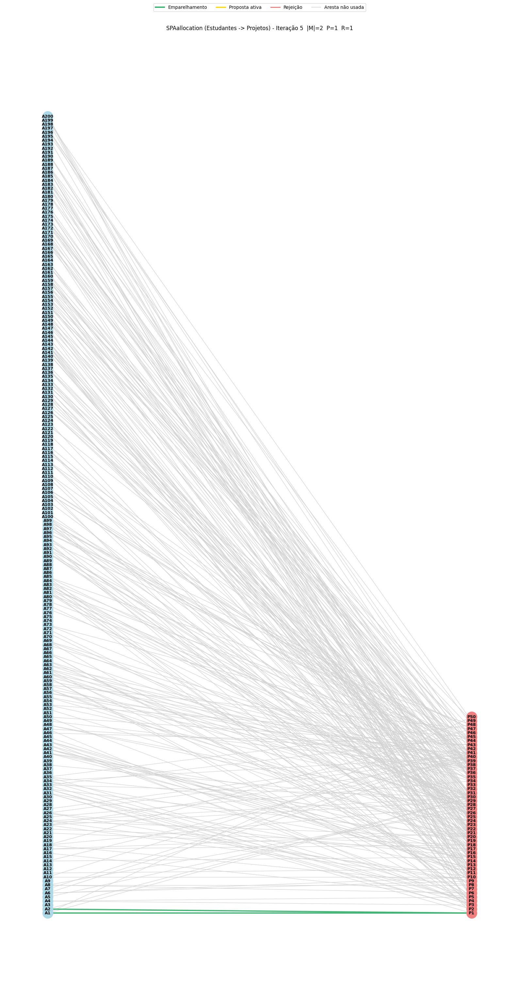

...

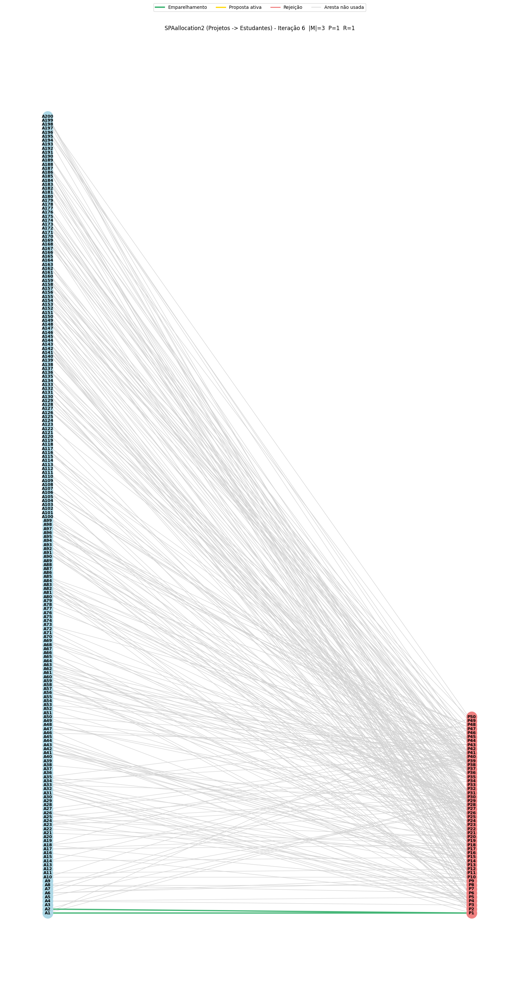

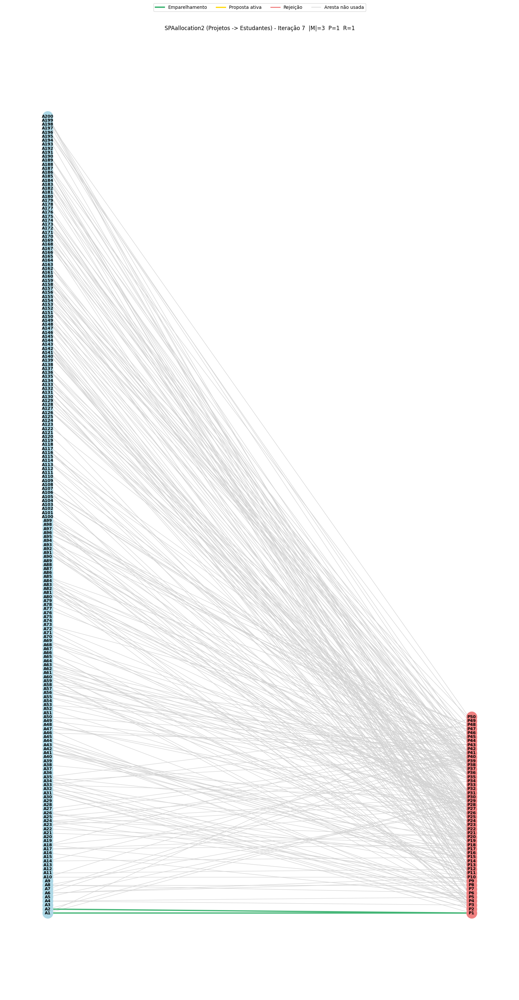

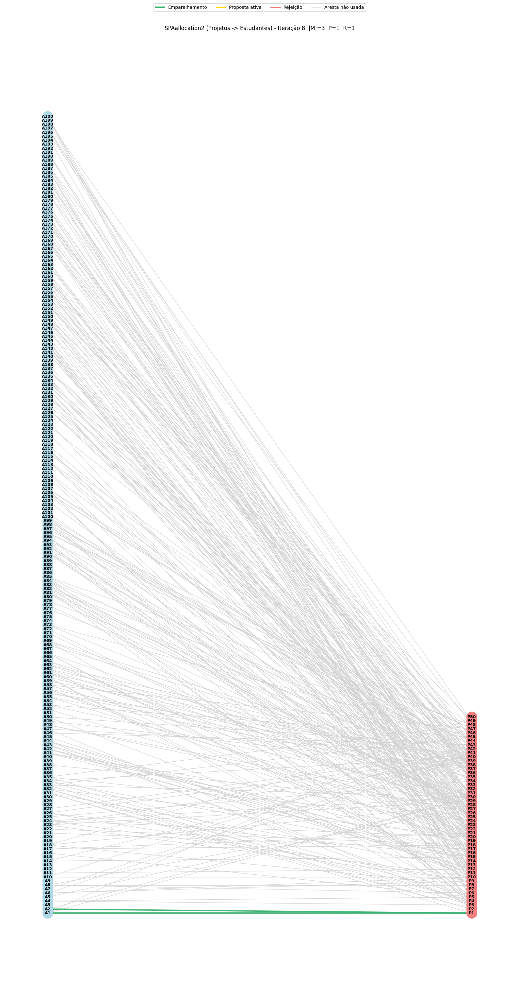

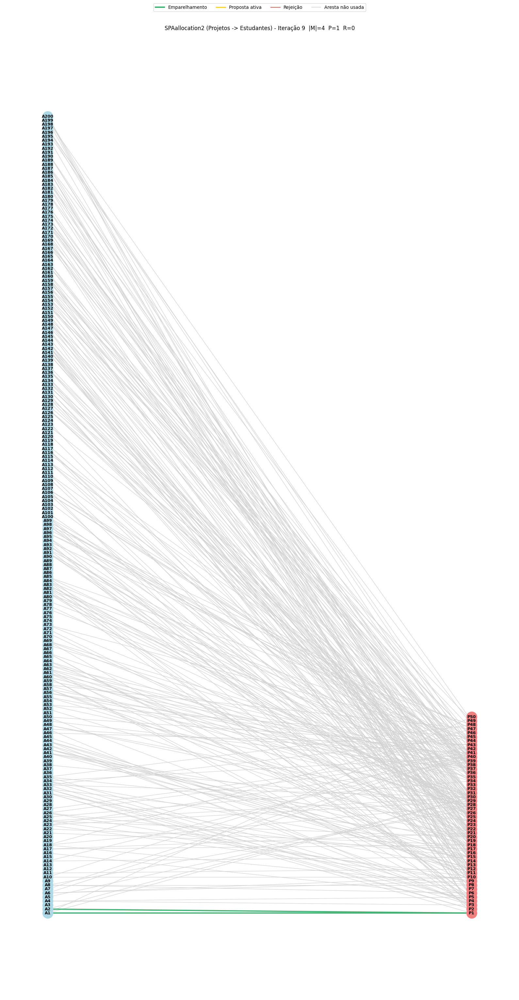

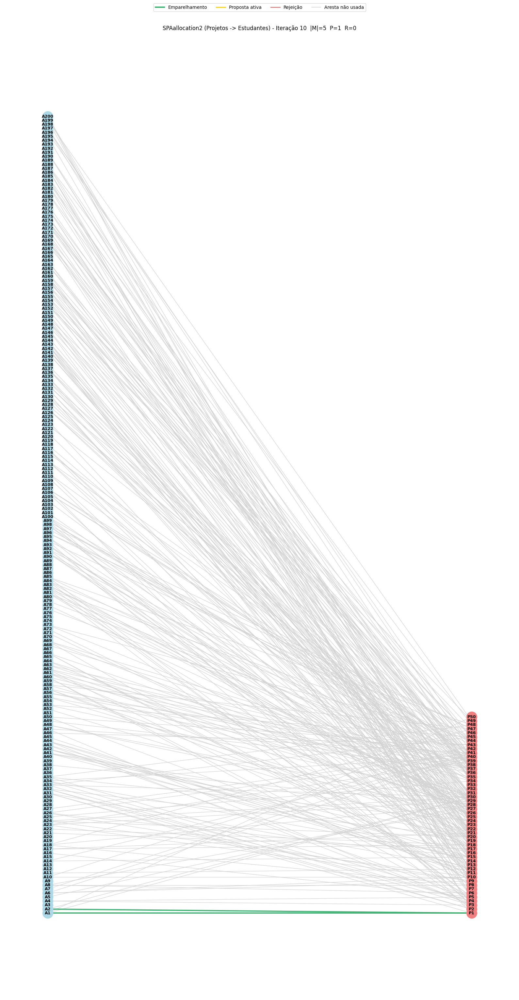

In [2]:
import os
import matplotlib.pyplot as plt
import networkx as nx
from matplotlib.lines import Line2D
from src.preprocessing import preprocessing
from src.SPAallocation import studentMeetsMoggingCriteria
from src.SPAallocation2 import SPAallocation2
def edge_key(a: str, b: str):
    return tuple(sorted((a, b)))
def build_base_graph():
    current_dir = os.getcwd()
    data_path = os.path.join(current_dir, "data", "data.txt")
    projects, students, projects2, students2 = preprocessing(data_path)
    G = nx.Graph()
    student_nodes = [s.code for s in students]
    project_nodes = [p.code for p in projects]
    G.add_nodes_from(student_nodes, bipartite=0)
    G.add_nodes_from(project_nodes, bipartite=1)
    for student in students:
        for project in student.prefList:
            if student.grade >= project.minGrade:
                G.add_edge(student.code, project.code)
    pos = {}
    vertical_spacing = 2
    for i, node in enumerate(student_nodes):
        pos[node] = (0, i * vertical_spacing)
    for i, node in enumerate(project_nodes):
        pos[node] = (10, i * vertical_spacing)
    return G, pos, (projects, students), (projects2, students2)
def snapshot_state(projects, proposals, rejections):
    matches = set()
    for proj in projects:
        for stu in proj.students:
            matches.add(edge_key(stu.code, proj.code))
    return {"matches": matches, "proposals": set(proposals), "rejections": set(rejections)}
def run_spa_with_trace(projects, students, max_iter=10):
    snapshots = []
    iteration = 0
    while any(stu.project is None and stu.didNotProposeToAll() for stu in students) and iteration < max_iter:
        proposals, rejections = set(), set()
        for student in students:
            if student.project is None and student.didNotProposeToAll():
                proposed_project = student.preferredProjectToBeProposed()
                proposals.add(edge_key(student.code, proposed_project.code))
                student.proposals.append(proposed_project)
                if student.grade >= proposed_project.minGrade:
                    if proposed_project.hasVacancies():
                        student.project = proposed_project
                        proposed_project.students.append(student)
                    elif studentMeetsMoggingCriteria(student, proposed_project):
                        mogged_student = proposed_project.studentToBeMogged()
                        mogged_student.project = None
                        proposed_project.students.remove(mogged_student)
                        rejections.add(edge_key(mogged_student.code, proposed_project.code))
                        student.project = proposed_project
                        proposed_project.students.append(student)
                    else:
                        rejections.add(edge_key(student.code, proposed_project.code))
                else:
                    rejections.add(edge_key(student.code, proposed_project.code))
                break
        snapshots.append(snapshot_state(projects, proposals, rejections))
        iteration += 1
    final_state = snapshot_state(projects, set(), set())
    while len(snapshots) < max_iter:
        snapshots.append(final_state)
    return snapshots
def student_prefers_new_project(student, new_project, old_project):
    new_pref = student.projectPreference(new_project)
    old_pref = student.projectPreference(old_project)
    if new_pref is None:
        return False
    if old_pref is None:
        return True
    return new_pref < old_pref
def run_spa2_with_trace(projects, students, max_iter=10):
    snapshots = []
    iteration = 0
    while any(project.hasVacancies() and project.didNotProposeToAll() for project in projects) and iteration < max_iter:
        proposals, rejections = set(), set()
        for project in projects:
            if project.hasVacancies() and project.didNotProposeToAll():
                candidate = project.preferredStudentToBeProposed()
                project.proposals.append(candidate)
                proposals.add(edge_key(candidate.code, project.code))
                if candidate.project is None:
                    candidate.project = project
                    project.students.append(candidate)
                else:
                    current_project = candidate.project
                    if student_prefers_new_project(candidate, project, current_project):
                        current_project.students.remove(candidate)
                        rejections.add(edge_key(candidate.code, current_project.code))
                        candidate.project = project
                        project.students.append(candidate)
                    else:
                        rejections.add(edge_key(candidate.code, project.code))
                break
        snapshots.append(snapshot_state(projects, proposals, rejections))
        iteration += 1
    final_state = snapshot_state(projects, set(), set())
    while len(snapshots) < max_iter:
        snapshots.append(final_state)
    return snapshots
def visualize_snapshots(G, pos, snapshots, title_prefix):
    student_nodes = [n for n, d in G.nodes(data=True) if d.get("bipartite") == 0]
    project_nodes = [n for n, d in G.nodes(data=True) if d.get("bipartite") == 1]
    legend_handles = [
        Line2D([0], [0], color="mediumseagreen", lw=3, label="Emparelhamento"),
        Line2D([0], [0], color="gold", lw=2.5, label="Proposta ativa"),
        Line2D([0], [0], color="lightcoral", lw=2.2, label="Rejeição"),
        Line2D([0], [0], color="lightgray", lw=1.2, label="Aresta não usada"),
    ]
    for idx, state in enumerate(snapshots):
        edge_colors, edge_widths = [], []
        for u, v in G.edges():
            key = edge_key(u, v)
            if key in state["matches"]:
                edge_colors.append("mediumseagreen")
                edge_widths.append(2.8)
            elif key in state["rejections"]:
                edge_colors.append("lightcoral")
                edge_widths.append(2.2)
            elif key in state["proposals"]:
                edge_colors.append("gold")
                edge_widths.append(2.4)
            else:
                edge_colors.append("lightgray")
                edge_widths.append(1.0)
        fig, ax = plt.subplots(figsize=(16, 30))
        nx.draw_networkx_nodes(G, pos, nodelist=student_nodes, node_color="lightblue", node_size=520, ax=ax)
        nx.draw_networkx_nodes(G, pos, nodelist=project_nodes, node_color="lightcoral", node_size=520, ax=ax)
        nx.draw_networkx_edges(G, pos, edge_color=edge_colors, width=edge_widths, alpha=0.95, ax=ax)
        nx.draw_networkx_labels(G, pos, font_size=9, font_weight="bold", ax=ax)
        ax.set_title(f"{title_prefix} - Iteração {idx + 1}  |M|={len(state['matches'])}  P={len(state['proposals'])}  R={len(state['rejections'])}", fontsize=12)
        ax.set_axis_off()
        fig.legend(handles=legend_handles, loc="upper center", ncol=4, bbox_to_anchor=(0.5, 1.02))
        plt.tight_layout()
        plt.show()
G, pos, (projects_spa, students_spa), (projects_spa2, students_spa2) = build_base_graph()
snapshots_spa = run_spa_with_trace(projects_spa, students_spa, max_iter=10)
snapshots_spa2 = run_spa2_with_trace(projects_spa2, students_spa2, max_iter=10)
visualize_snapshots(G, pos, snapshots_spa, "SPAallocation (Estudantes -> Projetos)")
visualize_snapshots(G, pos, snapshots_spa2, "SPAallocation2 (Projetos -> Estudantes)")

Após a execução completa do algoritmo, obtemos os seguintes emparelhamentos máximos para cada variante:

In [ ]:
from src.SPAallocation import SPAallocation, calculateProjectPreference
from src.SPAallocation2 import SPAallocation2, calculateProjectPreference2

# Preprocessar os dados para criar objetos de projetos e estudantes
projects, students, projects2, students2 = preprocessing(data_path)

# Executar ambas as variantes do algoritmo SPA
matching_spa = SPAallocation(projects, students)
matching_spa2 = SPAallocation2(projects2, students2)

spa_project_preference = calculateProjectPreference(projects, students)
spa2_project_preference = calculateProjectPreference2(projects2, students2)

# Construir o dicionário de emparelhamento a partir dos objetos de estudantes
if matching_spa is None:
    matching_spa = {s.code: s.project.code for s in students if s.project is not None}
if matching_spa2 is None:
    matching_spa2 = {s.code: s.project.code for s in students2 if s.project is not None}

# Gerar as imagens finais dos emparelhamentos - apenas vértices emparelhados
G_final_spa = nx.Graph()
matched_students_spa = list(matching_spa.keys())
matched_projects_spa = list(set(matching_spa.values()))
G_final_spa.add_nodes_from(matched_students_spa, bipartite=0)
G_final_spa.add_nodes_from(matched_projects_spa, bipartite=1)
for student_code, project_code in matching_spa.items():
    G_final_spa.add_edge(student_code, project_code)

G_final_spa2 = nx.Graph()
matched_students_spa2 = list(matching_spa2.keys())
matched_projects_spa2 = list(set(matching_spa2.values()))
G_final_spa2.add_nodes_from(matched_students_spa2, bipartite=0)
G_final_spa2.add_nodes_from(matched_projects_spa2, bipartite=1)
for student_code, project_code in matching_spa2.items():
    G_final_spa2.add_edge(student_code, project_code)

# Visualizar o emparelhamento final do SPAallocation
plt.figure(figsize=(16, 30))
pos_final = {}
vertical_spacing = 3
for i, node in enumerate(matched_students_spa):
    pos_final[node] = (0, i * vertical_spacing)
for i, node in enumerate(matched_projects_spa):
    pos_final[node] = (10, i * vertical_spacing)

nx.draw_networkx_nodes(G_final_spa, pos_final, nodelist=matched_students_spa, 
                       node_color='lightblue', node_size=500, 
                       label='Estudantes')
nx.draw_networkx_nodes(G_final_spa, pos_final, nodelist=matched_projects_spa, 
                       node_color='lightcoral', node_size=500, 
                       label='Projetos')
nx.draw_networkx_edges(G_final_spa, pos_final, alpha=0.7, edge_color='mediumseagreen', width=2)
nx.draw_networkx_labels(G_final_spa, pos_final, font_size=10, font_weight='bold')
plt.title(f'Emparelhamento Final - SPAallocation (|M|={len(matching_spa)})', fontsize=16)
plt.legend(scatterpoints=1, loc='upper right')
plt.axis('off')
plt.tight_layout()
plt.show()

# Visualizar o emparelhamento final do SPAallocation2
plt.figure(figsize=(16, 30))
pos_final2 = {}
for i, node in enumerate(matched_students_spa2):
    pos_final2[node] = (0, i * vertical_spacing)
for i, node in enumerate(matched_projects_spa2):
    pos_final2[node] = (10, i * vertical_spacing)

nx.draw_networkx_nodes(G_final_spa2, pos_final2, nodelist=matched_students_spa2, 
                       node_color='lightblue', node_size=500, 
                       label='Estudantes')
nx.draw_networkx_nodes(G_final_spa2, pos_final2, nodelist=matched_projects_spa2, 
                       node_color='lightcoral', node_size=500, 
                       label='Projetos')
nx.draw_networkx_edges(G_final_spa2, pos_final2, alpha=0.7, edge_color='mediumseagreen', width=2)
nx.draw_networkx_labels(G_final_spa2, pos_final2, font_size=10, font_weight='bold')
plt.title(f'Emparelhamento Final - SPAallocation2 (|M|={len(matching_spa2)})', fontsize=16)
plt.legend(scatterpoints=1, loc='upper right')
plt.axis('off')
plt.tight_layout()
plt.show()


ImportError: cannot import name 'bosta' from 'src.SPAallocation' (/Users/elvismirandajunior/Documents/Repos/Maximum_Bipartite_Matching/src/SPAallocation.py)

A partir do emparelhamento máximo obtido, podemos analisar a satisfação dos estudantes com base em suas preferências iniciais. A seguir, apresentamos uma matriz que mostra a distribuição dos estudantes alocados em relação às suas preferências para cada variante do algoritmo:

AttributeError: 'Student' object has no attribute 'projectPreferenceByCode'